# Deteccion de pelota en Software de simulacion de tennis (AO Tennis 2)



## Carga de archivos
Al utilizar Google Collab tendremos que cargar nuestros archivos a partir de una carpeta compartida del Drive.

Link de la carpeta: https://drive.google.com/drive/folders/16Sd4wpb-w8GLdhJoihCFpn_efjWhNRs2?usp=sharing

Se debe poner un acceso directo de la carpeta en el drive personal.

### Ejecucion en local
Los archivos deberian de estar en la misma carpeta que el notebook.


In [ ]:
try:
    import google.colab
    IN_COLAB = True
except:
    IN_COLAB = False

if IN_COLAB:
    from google.colab import drive
    drive.mount('/content/gdrive')

    import os
    os.chdir("/content/gdrive/MyDrive/VC_Tennis") #
else:
    # si no estamos en colab las imagenes o videos deberian estar donde el notebook
    pass
!ls

Mounted at /content/gdrive
ball_trace.mp4	  contour_video.mp4  media	      output_test.mp4
border_video.mp4  homo_video2.avi    output.mp4
bounce_video.mp4  homo_video2.mp4    output_part.mp4


In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
 
# Create a VideoCapture object and read from input file
# If the input is the camera, pass 0 instead of the video file name
cap = cv2.VideoCapture('./media/Videos/1-2_sets.mp4')
number_of_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps =  cap.get(cv2.CAP_PROP_FPS)
print("Number of frames: ", str(number_of_frames))
print("Width: ", str(width))
print("Height: ", str(height))
print("FPS: ", str(fps))


# Check if camera opened successfully
if (cap.isOpened()== False): 
  print("Error opening video stream or file")

# Create image array
limit_of_frames = 130
video = np.zeros([height,width,3,limit_of_frames],dtype=np.uint8)
starter_frame = 70 # First frames are useless
# Read until video is completed
i=0
j=0
while(cap.isOpened()):
  # Capture frame-by-frame
  if i >= limit_of_frames:
    break
  ret, frame = cap.read()

  if j <= starter_frame:
    j = j + 1
    continue

  if ret == True:
    video[:,:,:,i] = frame
    i = i + 1

    # Display the resulting frame
    #google.colab.patches.cv2_imshow(frame)
 
  # Break the loop
  else: 
    break
 
# When everything done, release the video capture object
cap.release()
 
# Closes all the frames
cv2.destroyAllWindows()


Number of frames:  8623
Width:  1920
Height:  1080
FPS:  30.0


In [ ]:
# Video display

import imageio
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from skimage.transform import resize
from IPython.display import HTML

def display_video(video, RGB = True):
    fig = plt.figure(figsize=(12.5,7))  #Display size specification

    mov = []
    length_range = 0
    if RGB == True:
      length_range = range(len(video[0,0,0,:]))
    else:
      length_range = range(len(video[0,0,:]))

    for i in length_range:  #Append videos one by one to mov
        if RGB == True:
          img = plt.imshow(video[:,:,:,i], animated=True)
        else:
          img = plt.imshow(video[:,:,i], animated=True)
        plt.axis('off')
        mov.append([img])

    #Animation creation
    anime = animation.ArtistAnimation(fig, mov, interval=50, repeat_delay=1000)

    plt.close()
    return anime

def save_video(video, name):
    fourcc = cv2.VideoWriter_fourcc(*'MP4V')
    out = cv2.VideoWriter(f'{name}.mp4', fourcc, 30, (width, height))
    
    for i in range(limit_of_frames):
        out.write(video[:, :, :, i])
    out.release()

    del out

#HTML(display_video(video).to_html5_video())  #Inline video display in HTML5

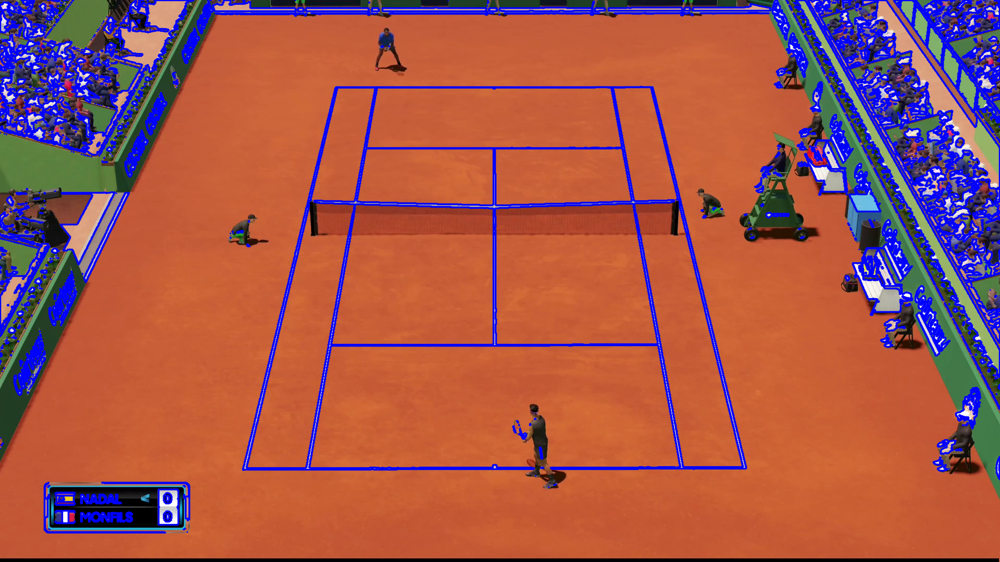

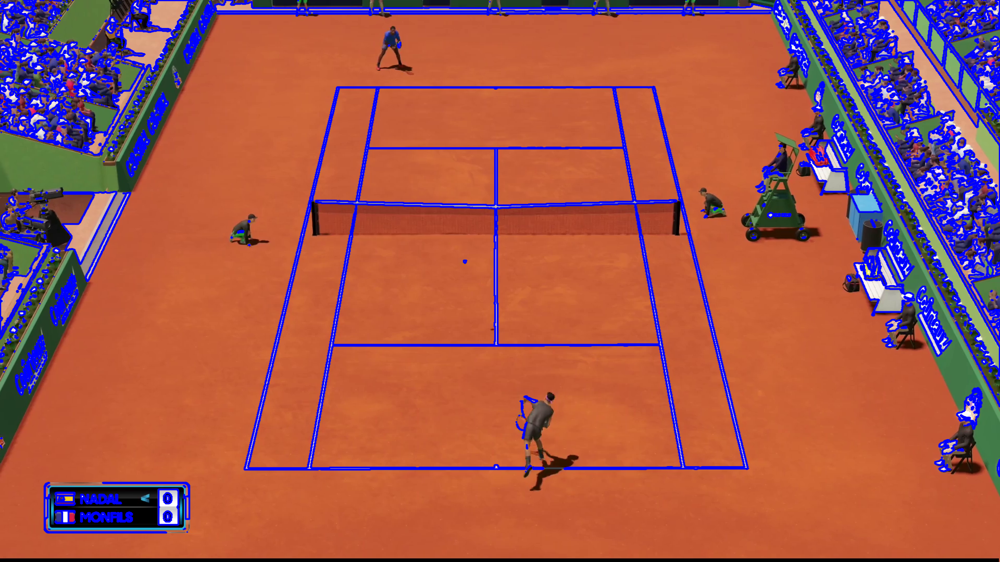

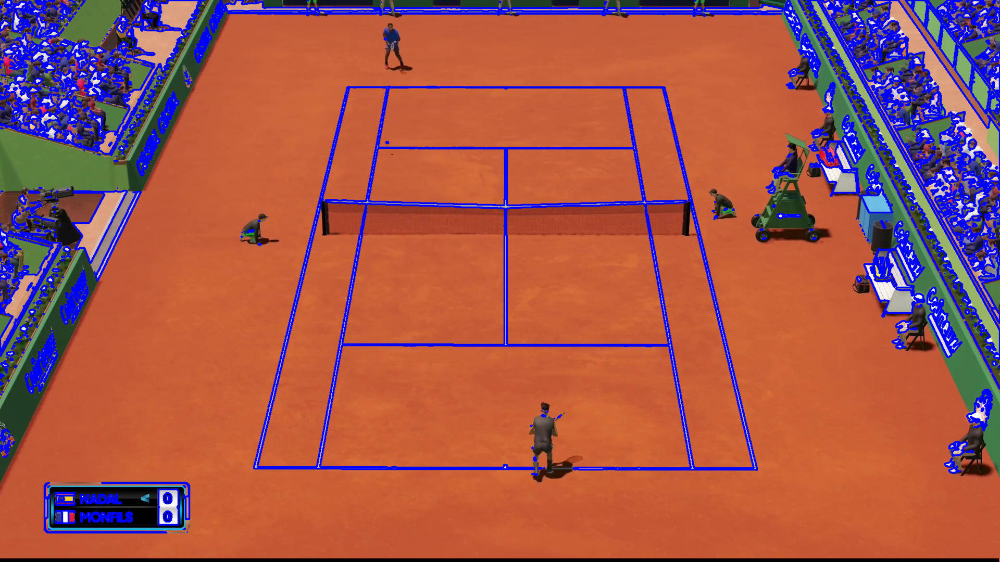

In [ ]:
########################### CONTOUR DETECTION ##############################

contour_video = np.zeros([height,width,3,limit_of_frames],dtype=np.uint8)

i = 0

while i < limit_of_frames:
  # convert the image to grayscale format
  img_gray = cv2.cvtColor(video[:,:,:,i], cv2.COLOR_BGR2GRAY)

  # apply binary thresholding
  ret, thresh = cv2.threshold(img_gray, 150, 255, cv2.THRESH_BINARY)

  # detect the contours on the binary image using cv2.CHAIN_APPROX_NONE
  contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_SIMPLE)
                                        
  # draw contours on the original image
  image_copy = video[:,:,:,i].copy()
  cv2.drawContours(image=image_copy, contours=contours, contourIdx=-1, color=(255, 0, 0), thickness=2, lineType=cv2.LINE_AA)
                  
  # see the results
  contour_video[:,:,:,i] = image_copy

  i = i + 1

google.colab.patches.cv2_imshow(contour_video[:,:,:,15])

google.colab.patches.cv2_imshow(contour_video[:,:,:,80])

google.colab.patches.cv2_imshow(contour_video[:,:,:,90])


In [ ]:
# Contour video display

HTML(display_video(contour_video).to_html5_video())

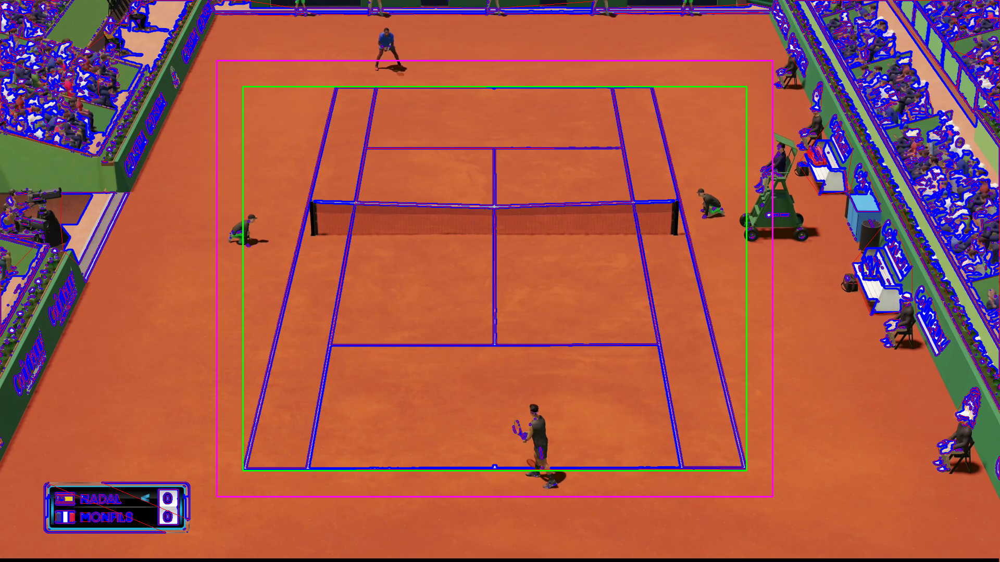

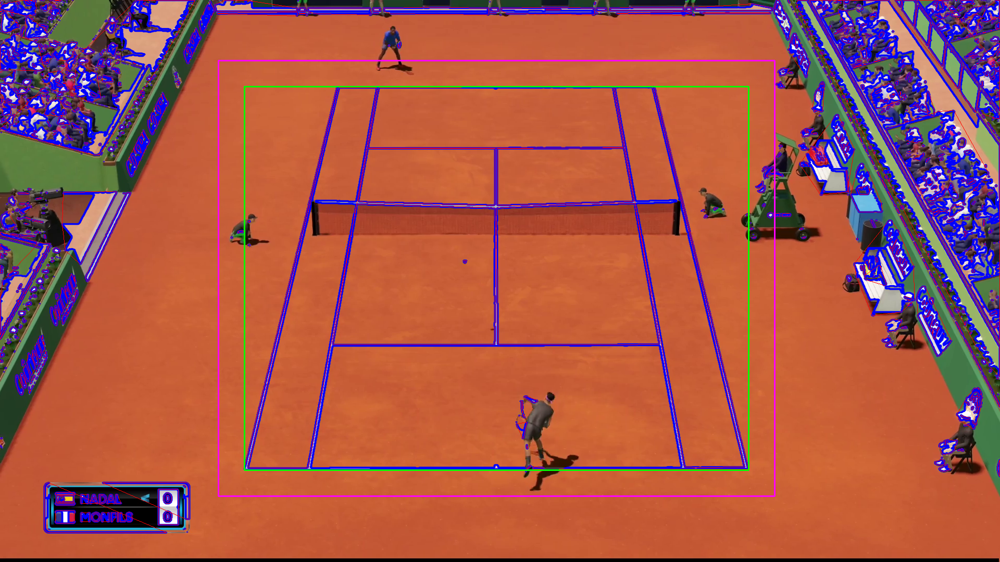

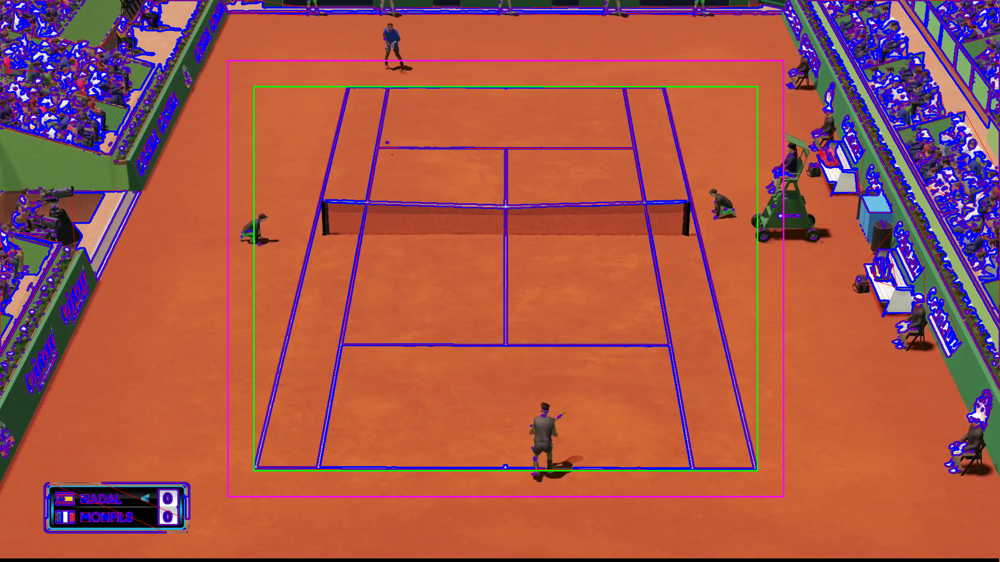

In [ ]:
########################### CONTOUR DETECTION ##############################

contour_video = np.zeros([height,width,3,limit_of_frames],dtype=np.uint8)

i = 0

while i < limit_of_frames:
    # convert the image to grayscale format
    img_gray = cv2.cvtColor(video[:,:,:,i], cv2.COLOR_BGR2GRAY)

    # apply binary thresholding
    ret, thresh = cv2.threshold(img_gray, 150, 255, cv2.THRESH_BINARY)

    # detect the contours on the binary image using cv2.CHAIN_APPROX_NONE
    contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)


    if len(contours) != 0:                          
        # draw contours on the original image
        image_copy = video[:,:,:,i].copy()
        cv2.drawContours(image=image_copy, contours=contours, contourIdx=-1, color=(255, 0, 0), thickness=2, lineType=cv2.LINE_AA)

        # find the biggest countour (c) by the area
        c = max(contours,key=cv2.contourArea)

        x,y,w,h = cv2.boundingRect(c)

        hull_list = []
        for j in range(len(contours)):
            hull = cv2.convexHull(contours[j])
            hull_list.append(hull)

        # Draw contours + hull results
        drawing = np.zeros((image_copy.shape[0], image_copy.shape[1], 3), dtype=np.uint8)
        for j in range(len(contours)):
            # color = (rng.randint(0,256), rng.randint(0,256), rng.randint(0,256))
            # cv2.drawContours(drawing, contours, i, (255, 0, 0)))
            cv2.drawContours(image=image_copy, contours=hull_list, contourIdx=j, color=(0, 0, 255))


        # draw the biggest contour (c) in green
        cv2.rectangle(image_copy,(x,y),(x+w,y+h),(0,255,0),2)
        cv2.rectangle(image_copy,(x-50,y-50),(x+w+50,y+h+50),(255,0,255),2)
        # see the results
        #cv2.imshow("Result", np.hstack([image, output]))
        contour_video[:,:,:,i] = image_copy

    i = i + 1

google.colab.patches.cv2_imshow(contour_video[:,:,:,15])

google.colab.patches.cv2_imshow(contour_video[:,:,:,80])

google.colab.patches.cv2_imshow(contour_video[:,:,:,90])

In [ ]:
# Contour video display

HTML(display_video(contour_video).to_html5_video())

In [ ]:
def get_image_hull(image):
    # Contorno campo
    img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # apply binary thresholding
    ret, thresh = cv2.threshold(img_gray, 150, 255, cv2.THRESH_BINARY)


    # detect the contours on the binary image using cv2.CHAIN_APPROX_NONE
    contours, hierarchy = cv2.findContours(image=thresh, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_NONE)

    if len(contours) != 0:                          
        # draw contours on the original image
        image_copy = image.copy()

        # find the biggest countour (c) by the area
        c = max(contours,key=cv2.contourArea)
        #cv2.drawContours(image=image_copy, contours=[c], contourIdx=-1, color=(255, 0, 0), thickness=2, lineType=cv2.LINE_AA)

        x,y,w,h = cv2.boundingRect(c)

        hull = cv2.convexHull(c)
        # print(len(hull))
        hull = cv2.approxPolyDP(hull, 300, True)
        hull = hull[:, 0, :]

        # print(hull)

        cv2.drawContours(image=image_copy, contours=[hull], contourIdx=-1, color=(0, 0, 255), thickness=2, lineType=cv2.LINE_AA)

        # draw the biggest contour (c) in green
        # cv2.rectangle(image_copy,(x,y),(x+w,y+h),(0,255,0),2)
        # cv2.rectangle(image_copy,(x-50,y-50),(x+w+50,y+h+50),(255,0,255),2)

        return image_copy, hull
    return image, []


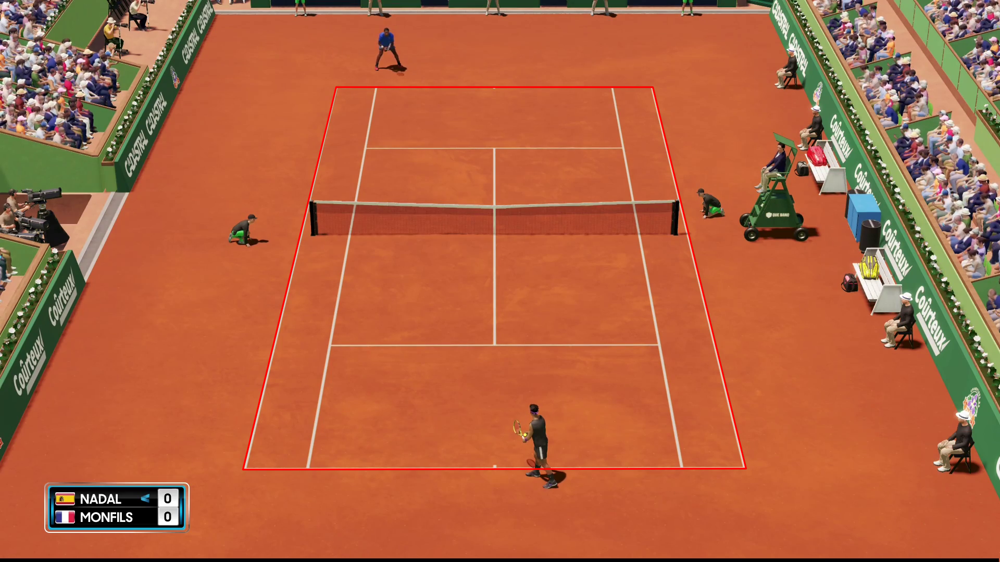

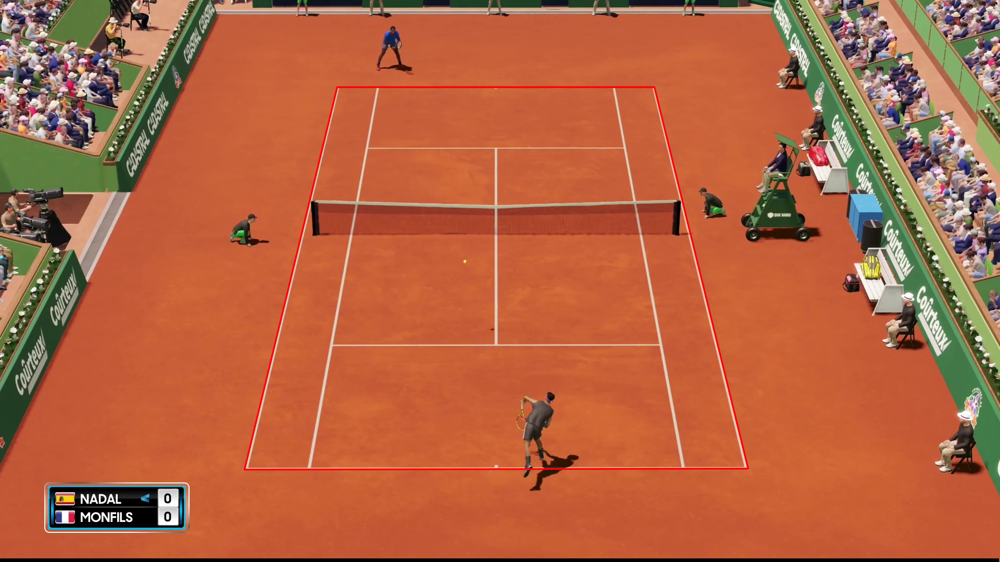

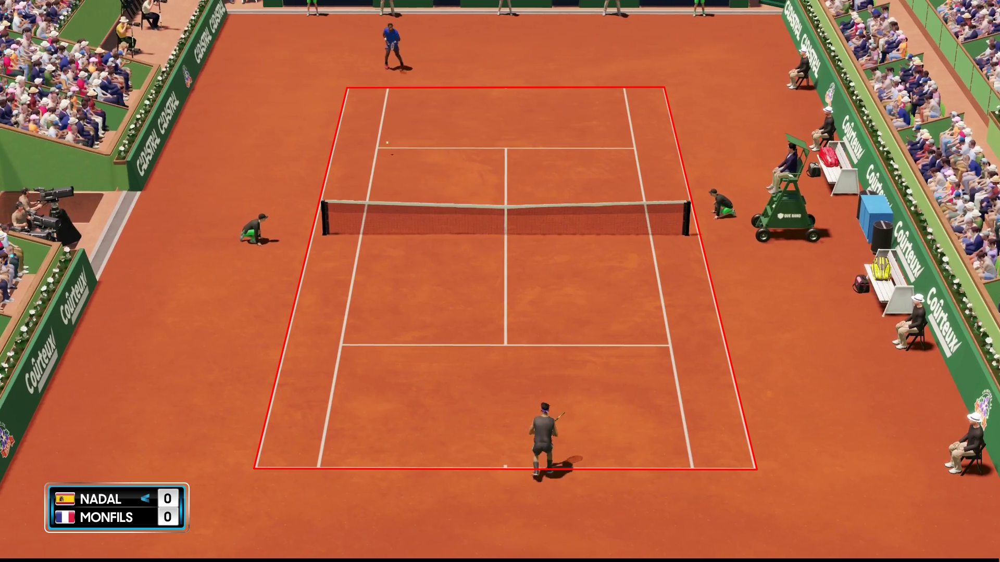

In [ ]:
########################### CONTOUR DETECTION ADVANCED ##############################

contour_video = np.zeros([height,width,3,limit_of_frames],dtype=np.uint8)
hulls = []

i = 0

while i < limit_of_frames:
  image_copy, hull = get_image_hull(video[:,:,:,i])
  contour_video[:,:,:,i] = image_copy
  hulls.append(hull)

  i = i + 1

google.colab.patches.cv2_imshow(contour_video[:,:,:,15])

google.colab.patches.cv2_imshow(contour_video[:,:,:,80])

google.colab.patches.cv2_imshow(contour_video[:,:,:,90])

In [ ]:
# Contour video display

HTML(display_video(contour_video).to_html5_video())

### Dimensiones Campo Tenis para la Homografia

Anchura: 10.97 m  
Largo: 23.77

hull1: [[1256  167]
 [1436  900]
 [ 469  902]
 [ 647  167]]
hull2: [[ 469  902]
 [ 647  167]
 [1256  167]
 [1436  900]]


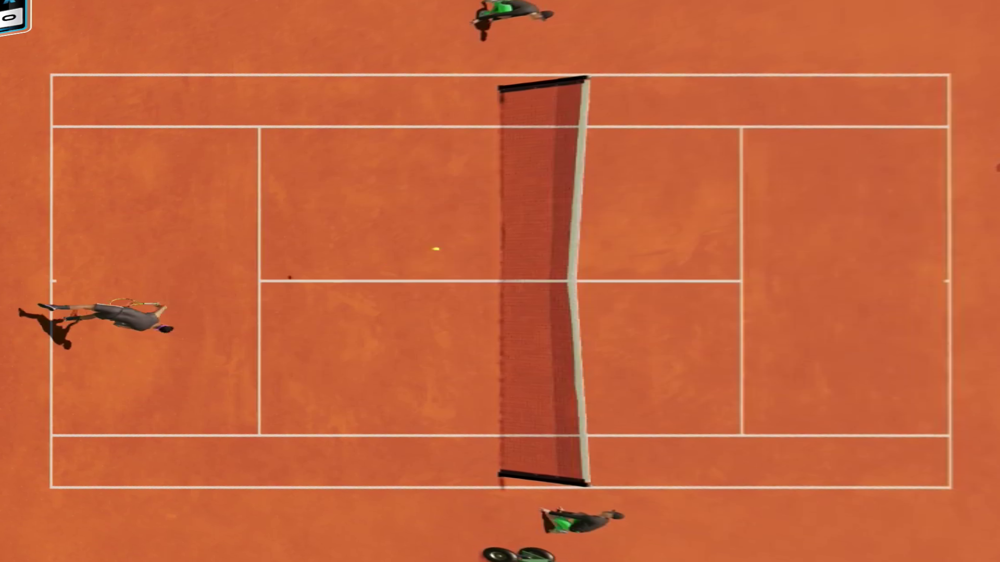

In [ ]:

def homography_tennis(image, hull, debug = False):
    if len(hull) != 4:
        return image
    # width values: 96, 1824   total_width : 1728 (90% of 1920)
    # 72.696676483 pixels per meter
    # height values: 141.26, 938.74   total_height: 797.48
    # rounded: 141, 939     total_height: 798

    if debug:
        print("hull1:", hull)
    hull=hull[np.argsort(hull[:, 0])]       # ordenamos segun posicion en x para que este mas controlado el orden
    if debug:
        print("hull2:",hull)

    # posiciones homografia
    up_left = np.array([96, 141])
    up_right = np.array([1824, 141])
    down_left = np.array([96, 939])
    down_right = np.array([1824, 939])

    points = np.array([up_left, up_right, down_right, down_left]) # ordenados para que coincidan con los puntos anteriores

    h, status = cv2.findHomography(hull, points)
    out = cv2.warpPerspective(image, h, [1920, 1080])
    return out

result = homography_tennis(video[:, :, :, 80], hulls[80], debug=True)

google.colab.patches.cv2_imshow(result)

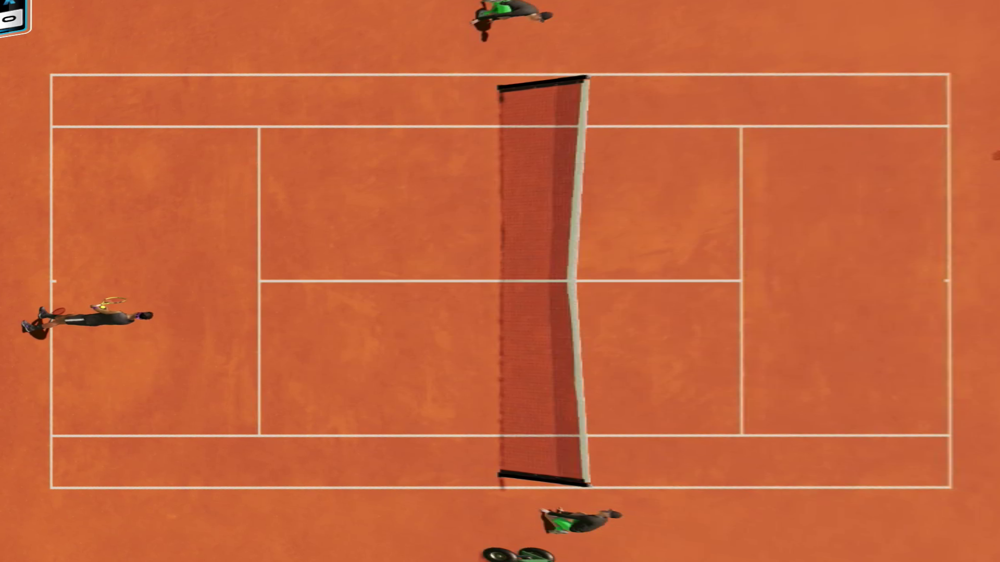

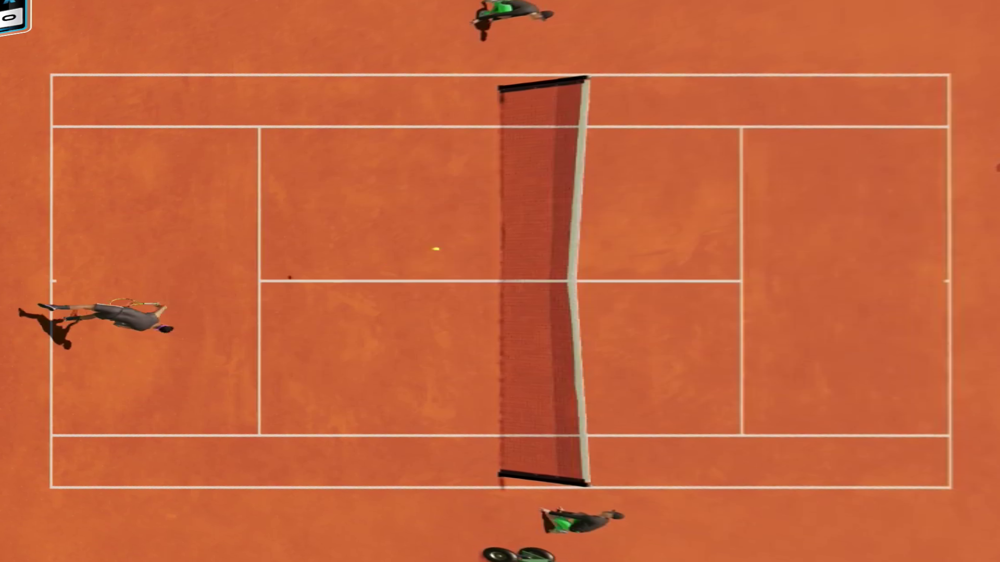

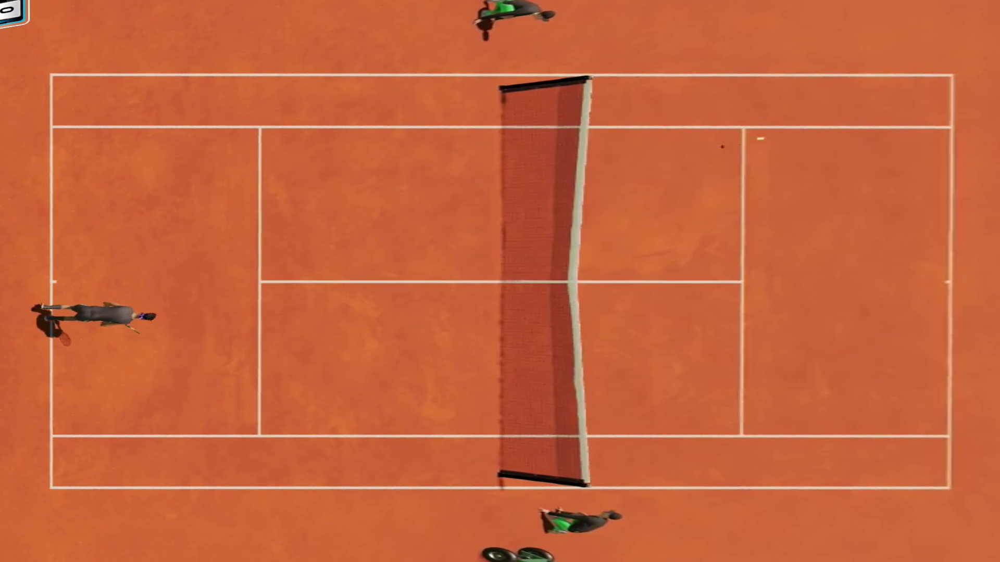

In [ ]:
homo_video = np.zeros([height,width,3,limit_of_frames],dtype=np.uint8)

i = 0

while i < limit_of_frames:
  image_copy = homography_tennis(video[:,:,:,i], hulls[i])
  homo_video[:,:,:,i] = image_copy

  i = i + 1

google.colab.patches.cv2_imshow(homo_video[:,:,:,15])

google.colab.patches.cv2_imshow(homo_video[:,:,:,80])

google.colab.patches.cv2_imshow(homo_video[:,:,:,90])

In [ ]:
# Contour video display

HTML(display_video(homo_video).to_html5_video())

In [ ]:
def segment_ball(image):
    # Convertir la imagen de BGR a HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definir el rango de colores en HSV para la pelota de tenis
    lower_yellow = np.array([25, 100, 100])
    upper_yellow = np.array([35, 255, 255])

    # Umbralizar la imagen en función del rango de colores
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar una operación de apertura (erosión seguida de dilatación) para eliminar el ruido
    kernel = np.ones((3, 3), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.dilate(mask, kernel)

    # Encontrar contornos en la imagen umbralizada
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    return hsv,contours, mask


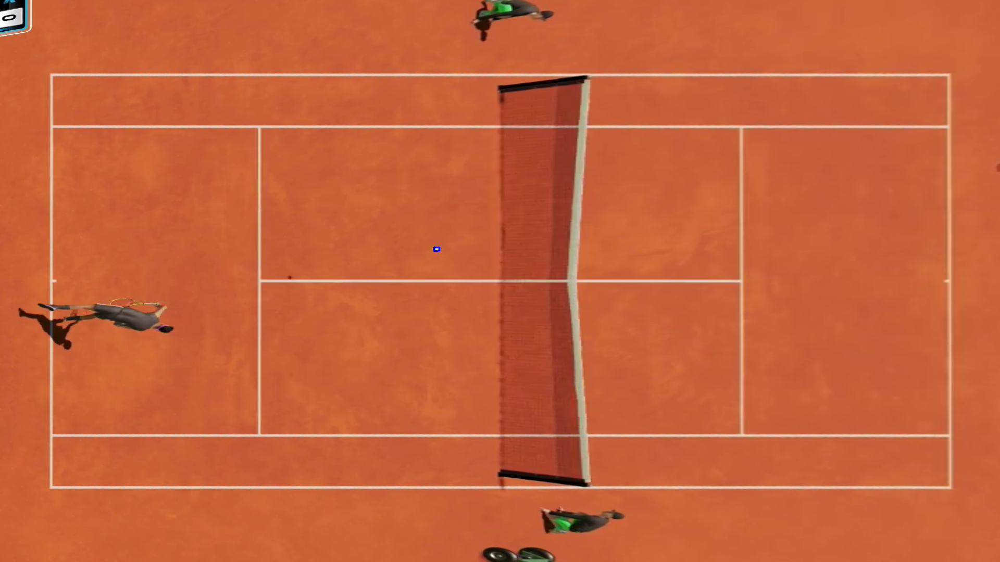

In [ ]:
i=0
result=homo_video.copy()

while i < limit_of_frames:
  # Segmentar la pelota de tenis
  image = homo_video[:,:,:,i].copy()
  hsv,contours, mask = segment_ball(image)

  # Dibujar contornos en la imagen original

  result[:,:,:,i] = cv2.drawContours(image, contours, -1, (250, 0, 0), 2,lineType=cv2.LINE_AA)
  i+=1

# Mostrar las imágenes

google.colab.patches.cv2_imshow( result[:,:,:,80])

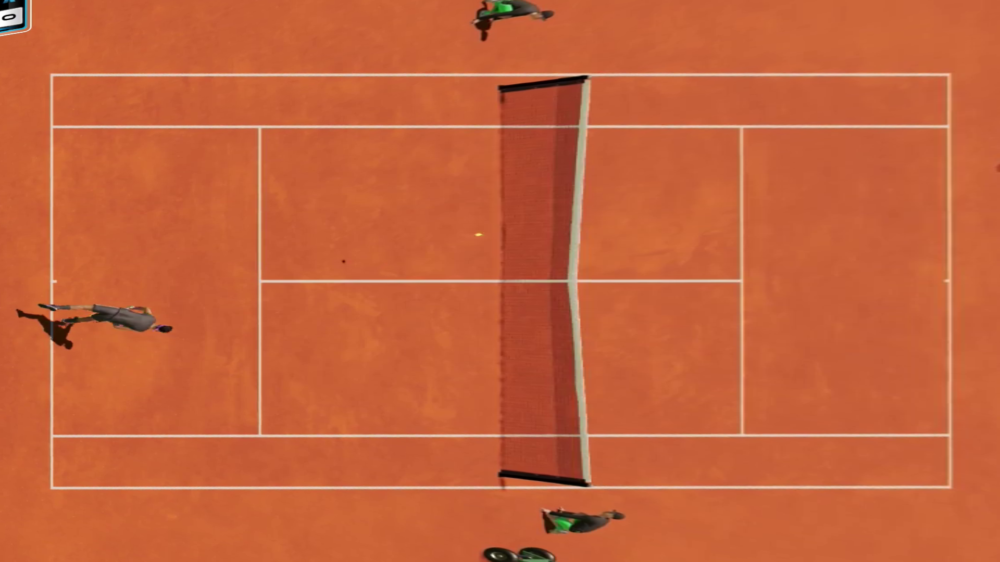

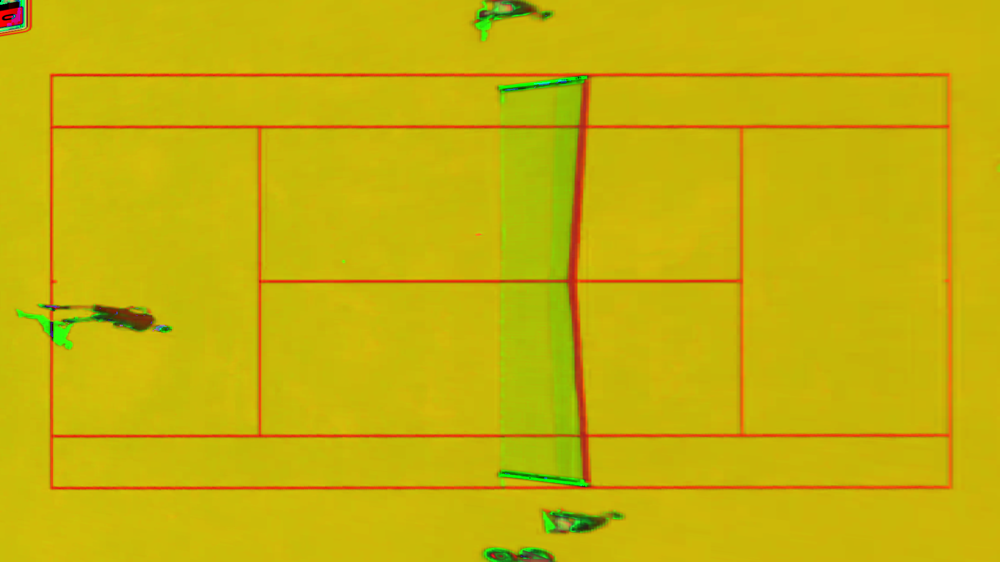

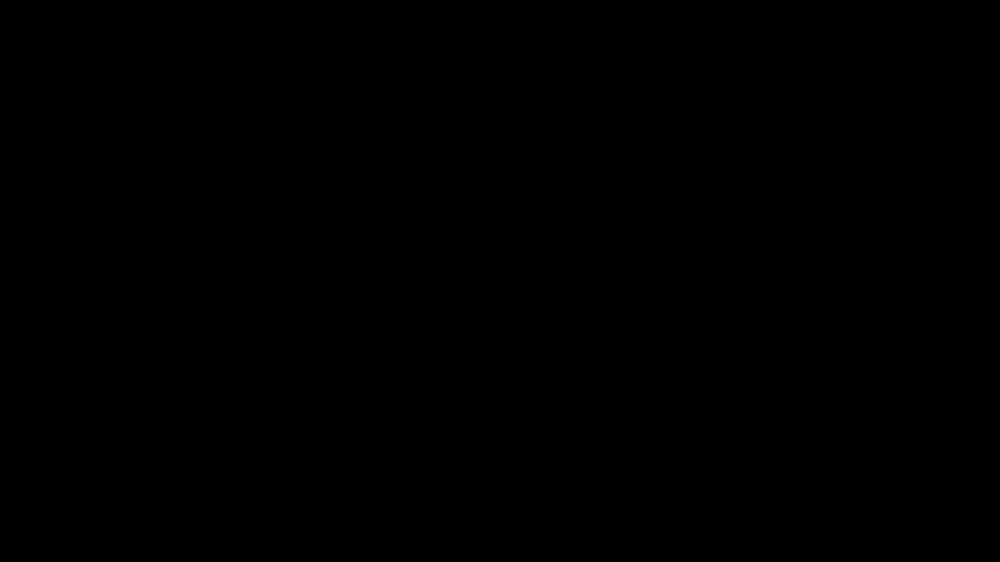

()


In [ ]:
result=homo_video.copy()
ima=result[:,:,:,81].copy()

hsv,contours, mask = segment_ball(ima)

a=cv2.drawContours(ima, contours, -1, (250, 0, 0), 2,lineType=cv2.LINE_AA)


google.colab.patches.cv2_imshow(a)
google.colab.patches.cv2_imshow(hsv)
google.colab.patches.cv2_imshow(mask)

print(contours)

In [ ]:
# Video trackeo bola

result=homo_video.copy()

i = 0

while i < limit_of_frames:
  image_copy = homography_tennis(video[:,:,:,i], hulls[i])
  ima=result[:,:,:,i].copy()
  hsv,contours, mask = segment_ball(ima)

  a=cv2.drawContours(ima, contours, -1, (250, 0, 0), 2,lineType=cv2.LINE_AA)
  result[:,:,:,i] = a

  i = i + 1

HTML(display_video(result).to_html5_video())

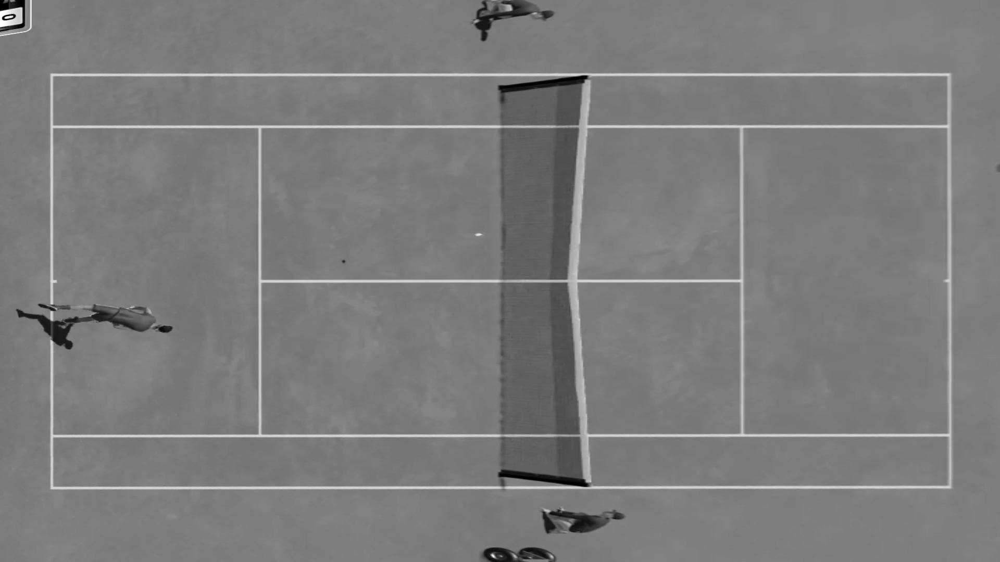

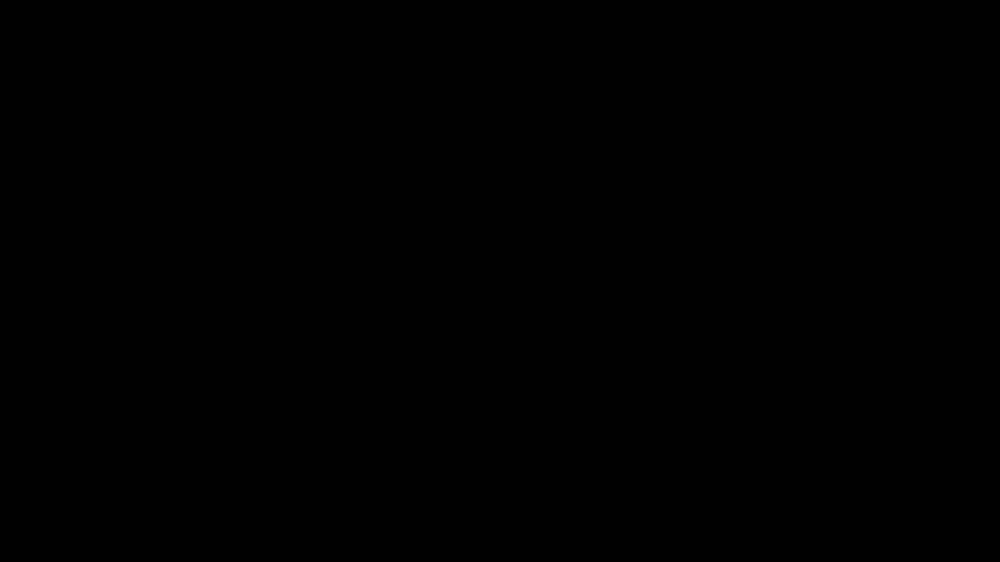

In [ ]:

# medidas aprox pelota 7,12
#cuadrado a busca 120 x 120

#contorno frame anterior 



plantilla = np.zeros((7,12),dtype=np.uint8)
plantilla[:,:]=250

img= cv2.cvtColor(result[:,:,:,81].copy(), cv2.COLOR_BGR2GRAY)

res = cv2.matchTemplate(img, plantilla, cv2.TM_CCOEFF_NORMED)
google.colab.patches.cv2_imshow(plantilla)
google.colab.patches.cv2_imshow( img)
google.colab.patches.cv2_imshow( res)



# Aplicar la correlación cruzada a la imagen
#res = cv2.matchTemplate(img, plantilla, cv2.TM_CCOEFF_NORMED)


#dibujar rectangulo


#idea
#buscar corralacion en bloque limitado ya que no se movera mucho la pelota

#idea
#probar estimacion lineal sino consigo encotrarlo en un frame puedo estimarlo con los otros


In [ ]:

def segment_ball2(image):
    # Convertir la imagen de BGR a HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definir el rango de colores en HSV para la pelota de tenis
    lower_yellow = np.array([25, 100, 100])
    upper_yellow = np.array([35, 255, 255])

    # Umbralizar la imagen en función del rango de colores
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar una operación de apertura (erosión seguida de dilatación) para eliminar el ruido
    kernel = np.ones((3, 3), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.dilate(mask, kernel)

    # Encontrar contornos en la imagen umbralizada
    #contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    return mask#contours, mask


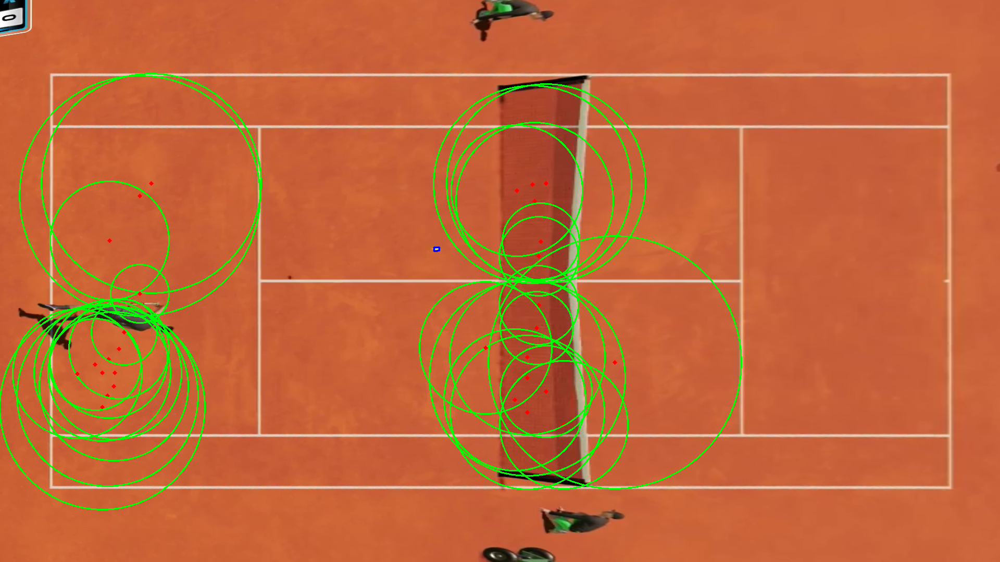

In [ ]:
img = result[:,:,:,80].copy()

#resultado = segment_ball2(img)

#mask = cv2.medianBlur(mask,5)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
mask = cv2.GaussianBlur(gray,(5,5),2)

circles = cv2.HoughCircles(gray, cv2.HOUGH_GRADIENT, 1, 20, param1=50, param2=50, minRadius=0, maxRadius=0)

circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    # draw the outer circle
    cv2.circle(img,(i[0],i[1]),i[2],(0,255,0),2)
    # draw the center of the circle
    cv2.circle(img,(i[0],i[1]),2,(0,0,255),3)

google.colab.patches.cv2_imshow( img)



In [ ]:
def segment_ball_detected(image):
    # Convertir la imagen de BGR a HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definir el rango de colores en HSV para la pelota de tenis
    lower_yellow = np.array([25, 100, 100])
    upper_yellow = np.array([35, 255, 255])

    # Umbralizar la imagen en función del rango de colores
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar una operación de apertura (erosión seguida de dilatación) para eliminar el ruido
    kernel = np.ones((3, 3), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.dilate(mask, kernel)

    # Encontrar contornos en la imagen umbralizada
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    return hsv,contours, mask

from statistics import mean

In [ ]:
def segment_ballHSV(image):

    # Convertir la imagen de BGR a HSV
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definir el rango de colores en HSV para la pelota de tenis
    lower_yellow = np.array([25, 100, 100])
    upper_yellow = np.array([35, 255, 255])

    # Umbralizar la imagen en función del rango de colores
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar una operación de apertura (erosión seguida de dilatación) para eliminar el ruido
    kernel = np.ones((3, 3), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.dilate(mask, kernel)

    # Encontrar contornos en la imagen umbralizada
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    return contours,mask



def segment_ballGRAY(image,tipo):

    # Convertir la imagen de BGR a HSV
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Definir el rango de colores en HSV para la pelota de tenis
    
    lower_white = 225

    upper_white = 250

    # Umbralizar la imagen en función del rango de colores
    mask = cv2.inRange(gray, lower_white, upper_white)
    
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.dilate(mask, kernel)

    # Encontrar contornos en la imagen umbralizada
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    return contours,mask


def segment_ball(image,tipo):
  contours,mask = segment_ballHSV(image)
  if not contours:
    contours,mask = segment_ballGRAY(image,tipo)
 
  return contours,mask


def contorn_in(contours):
  #pista desde altrua 150: maxh-150, ancho 100:maxw-100
  
  maxh=1080-150
  maxw=1920-100
  contornos_valid=[]

  for contor in contours:
    #print(contor)
    t=True
    for aux in contor:
      #print(aux[0][1],aux[0][0])



      if not (aux[0][1] > 150 and aux[0][1] < maxh): #and aux[0][0] > 100 and aux[0][0] < maxw):
        t=False
        break
    if t:
      contornos_valid.append(contor)

  return contornos_valid

In [ ]:

result=homo_video.copy()

h=300

w=300
contours=[]
i=0

while i < limit_of_frames:
   #Segmentar la pelota de tenis
  image = result[:,:,:,i].copy()
  if i > 0 and contours[i-1]:
    con0=contours[i-1][0][0][0][0] #columnas
    con1=contours[i-1][0][0][0][1] #filas
    con0mensw=max(0,int(con0-(w/2)))
    con1menh=max(0,int(con1-(h/2)))
    con0masw=min(np.shape(image)[1],int(con0+(w/2)))
    con1mash=min(np.shape(image)[0],int(con1+(h/2)))
    img_cort=image[con1menh:con1mash,con0mensw:con0masw].copy()
    aux,mask=segment_ball(img_cort,0)
    if aux:
      for contorno in aux[0]:
        contorno[0][0] += con0mensw
        contorno[0][1] += con1menh
    contours.append(aux)
    print(i)
    print(contours[i])
    result[:,:,:,i] = cv2.drawContours(image, contours[i], -1, (250, 0, 0), 2,lineType=cv2.LINE_AA)
  else:
    aux,mask=segment_ball(image,1)
    if aux:
      print(i)
      #print(aux)
      aux=contorn_in(aux)
      print(aux)
      contours.append(aux)
      result[:,:,:,i] = cv2.drawContours(image, contours[i], -1, (250, 0, 0), 2,lineType=cv2.LINE_AA)
    


  i+=1





# Mostrar las imágenes
#result[:,:,:,i] = cv2.drawContours(result[:,:,:,0].copy(), contours[0], -1, (250, 0, 0), 2,lineType=cv2.LINE_AA)
#google.colab.patches.cv2_imshow( result[:,:,:,85])
#google.colab.patches.cv2_imshow( result[:,:,:,86])



0
[array([[[192, 586]],

       [[192, 594]],

       [[201, 594]],

       [[201, 586]]], dtype=int32)]
1
(array([[[192, 586]],

       [[192, 594]],

       [[201, 594]],

       [[201, 586]]], dtype=int32),)
2
(array([[[192, 586]],

       [[192, 594]],

       [[201, 594]],

       [[201, 586]]], dtype=int32),)
3
(array([[[192, 586]],

       [[192, 594]],

       [[201, 594]],

       [[201, 586]]], dtype=int32),)
4
(array([[[192, 586]],

       [[192, 594]],

       [[201, 594]],

       [[201, 586]]], dtype=int32),)
5
(array([[[192, 586]],

       [[192, 594]],

       [[201, 594]],

       [[201, 587]],

       [[200, 586]]], dtype=int32),)
6
(array([[[192, 586]],

       [[192, 594]],

       [[201, 594]],

       [[201, 587]],

       [[200, 586]]], dtype=int32),)
7
(array([[[192, 586]],

       [[192, 594]],

       [[201, 594]],

       [[201, 587]],

       [[200, 586]]], dtype=int32),)
8
(array([[[192, 586]],

       [[192, 594]],

       [[201, 594]],

       [[201, 587]

In [ ]:
save_con=contours.copy()

In [ ]:
HTML(display_video(result).to_html5_video())

In [ ]:
import copy



i=0
resu=result.copy()
contours=save_con.copy()

while i < limit_of_frames:
  if not contours[i]:
    print(i)
    a=i-1 #por debajo
    
    #while not contours[a]:
    #  a-=1
    b=a-1 
    #while not contours[b]:
    #  b-=1
    image=resu[:,:,:,i].copy()
    print(a,b,contours[a],contours[b])
    mean=(np.around(np.mean(contours[a],axis=(0,1)))-np.around(np.mean(contours[b],axis=(0,1))))
    print(mean)
    try:
      mean=[int(mean[0]),int(mean[1])]
    except:
      mean=[int(mean[0][0]),int(mean[0][1])]

    con_aux=copy.deepcopy(contours[a])
    #print(con_aux)
    #print(mean)
    boo=False
    for contorno in con_aux[0]:
      contorno[0][0] += mean[0]
      contorno[0][1] += mean[1]
      if contorno[0][0] < 0 and contorno[0][1] < 0 and contorno[0][0] > 1920 and contorno[0][1] < 1080:
        boo=True
    print(con_aux)

    if not boo:
      print(i)

      contours[i]=con_aux
      resu[:,:,:,i] = cv2.drawContours(image, contours[i], -1, (250, 0, 0), 2,lineType=cv2.LINE_AA)

    

      
  #result[:,:,:,i] = cv2.drawContours(image, contours[i], -1, (250, 0, 0), 2,lineType=cv2.LINE_AA)
  i+=1

78
77 76 (array([[[473, 599]],

       [[472, 600]],

       [[472, 604]],

       [[473, 605]],

       [[480, 605]],

       [[481, 604]],

       [[482, 604]],

       [[482, 600]],

       [[480, 600]],

       [[479, 599]]], dtype=int32),) (array([[[479, 599]],

       [[479, 605]],

       [[480, 606]],

       [[487, 606]],

       [[488, 605]],

       [[489, 605]],

       [[489, 599]]], dtype=int32),)
[[-7. -2.]]
(array([[[466, 597]],

       [[465, 598]],

       [[465, 602]],

       [[466, 603]],

       [[473, 603]],

       [[474, 602]],

       [[475, 602]],

       [[475, 598]],

       [[473, 598]],

       [[472, 597]]], dtype=int32),)
78
82
81 80 (array([[[917, 448]],

       [[916, 449]],

       [[914, 449]],

       [[914, 453]],

       [[918, 453]],

       [[919, 452]],

       [[924, 452]],

       [[924, 448]]], dtype=int32),) (array([[[833, 475]],

       [[833, 482]],

       [[839, 482]],

       [[840, 481]],

       [[843, 481]],

       [[843, 475]]], 

In [ ]:
HTML(display_video(resu).to_html5_video())

In [ ]:
save_video(resu, 'aerea')

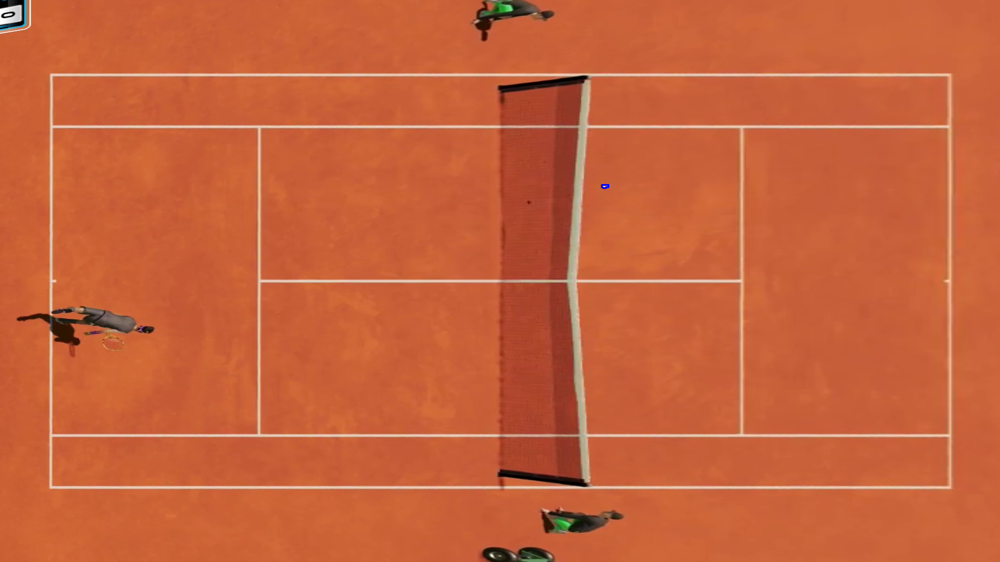

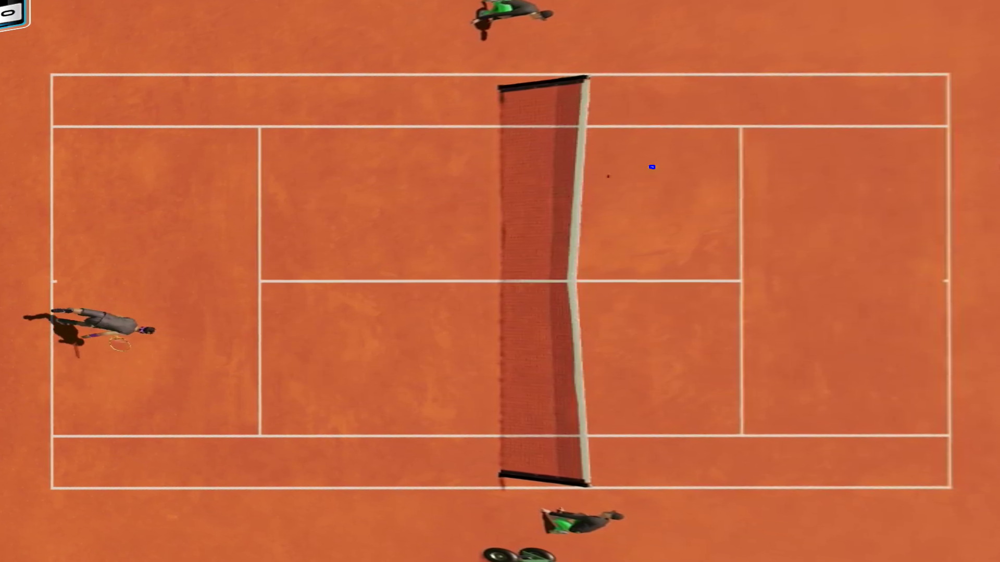

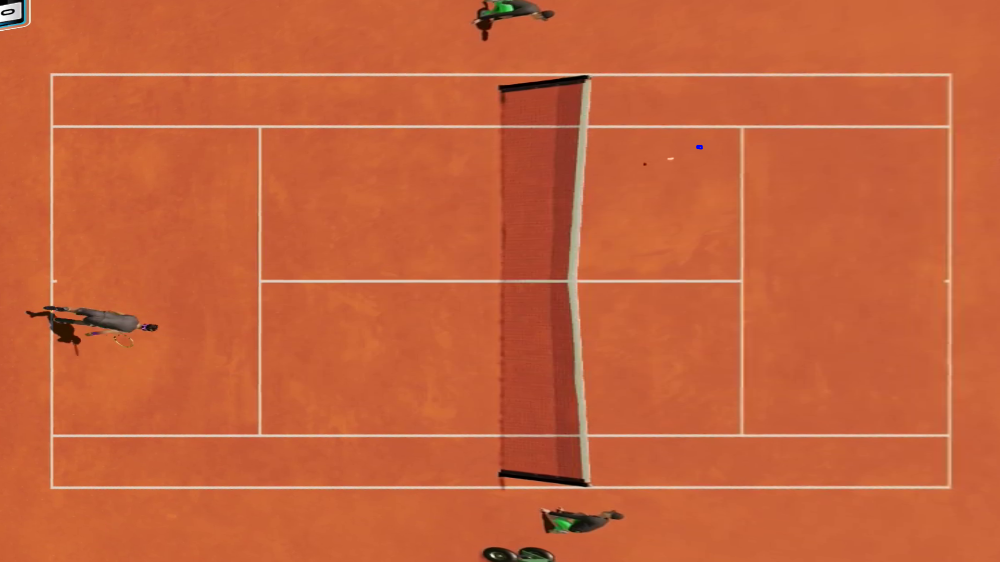

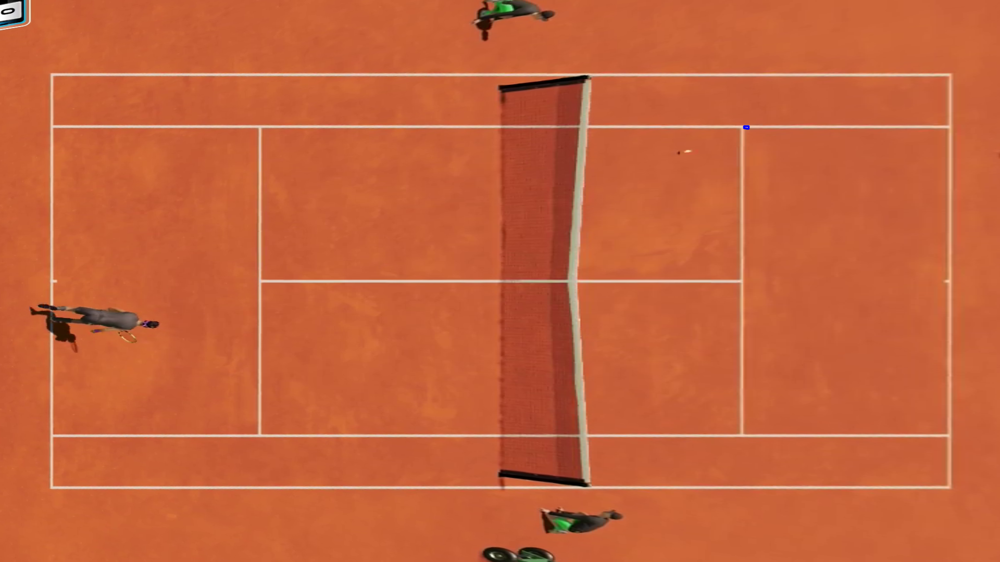

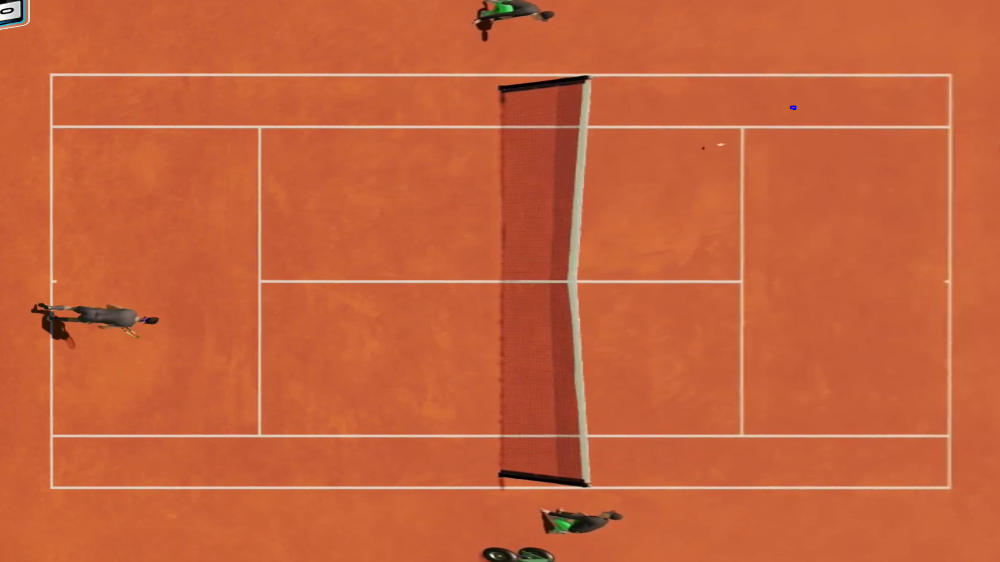

In [ ]:

google.colab.patches.cv2_imshow( resu[:,:,:,85])
google.colab.patches.cv2_imshow( resu[:,:,:,86])
google.colab.patches.cv2_imshow( resu[:,:,:,87])
google.colab.patches.cv2_imshow( resu[:,:,:,88])
google.colab.patches.cv2_imshow( resu[:,:,:,89])

In [ ]:

velocity = 0
speeds = []
coords = []
last_position = []
last_good_frame = 0
i = 0

for con_aux in contours:
  if len(con_aux) > 0:
    con_aux = con_aux[0]
    con_aux = con_aux[:,0,:]
    centroid = np.mean(con_aux, axis=0)
    print(centroid)
    if len(last_position) > 0:
      dist = np.array(centroid) - np.array(last_position)
      dist = np.linalg.norm(dist) ## Euclidean distance
      velocity = (dist / 72.72) / (i - last_good_frame) * 30 # 72,72 px/m
      if velocity < 65:
        speeds.append(velocity)
      coords.append(centroid)
    last_position = centroid
    last_good_frame = i
  i = i + 1

[196.5 590. ]
[196.5 590. ]
[196.5 590. ]
[196.5 590. ]
[196.5 590. ]
[197.2 589.4]
[197.2 589.4]
[197.2 589.4]
[197.2 589.4]
[197.2 589.4]
[197.2 589.4]
[197.2 589.4]
[197.2 589.4]
[197.2 589.4]
[197.2 589.4]
[197.2 589.4]
[197.2 589.4]
[196.5 590. ]
[196.5 590. ]
[196.5 590. ]
[195.42857143 590.28571429]
[195.42857143 590.28571429]
[195.42857143 590.28571429]
[195.42857143 590.28571429]
[195.25 590.  ]
[197.9047619  587.19047619]
[203.9 588.4]
[209.375 589.875]
[215.57142857 588.42857143]
[220.   590.25]
[218.83333333 594.33333333]
[221.5 595. ]
[225.16666667 595.66666667]
[224.5 598. ]
[225.14285714 599.14285714]
[225.57142857 601.42857143]
[225.16666667 603.33333333]
[222.14285714 604.28571429]
[219.8 603.4]
[217.2 603.6]
[215. 602.]
[210.44444444 602.        ]
[201.8 599. ]
[199.11111111 600.44444444]
[196.5 598. ]
[191.5 596. ]
[190.57142857 592.71428571]
[186.         590.66666667]
[184.         591.33333333]
[184. 589.]
[185.    587.625]
[188.5 584.5]
[192.33333333 582.        

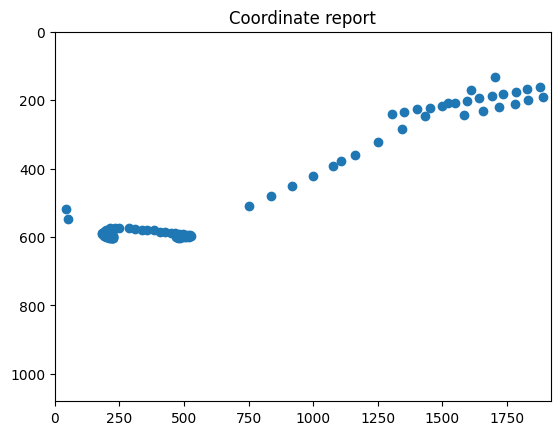

In [ ]:
# coords
coords = np.array(coords)
plt.scatter(coords[:,0], coords[:,1])
plt.gca().update(dict(title='Coordinate report', ylim=(1080,0), xlim=(0,1920)))
plt.show()

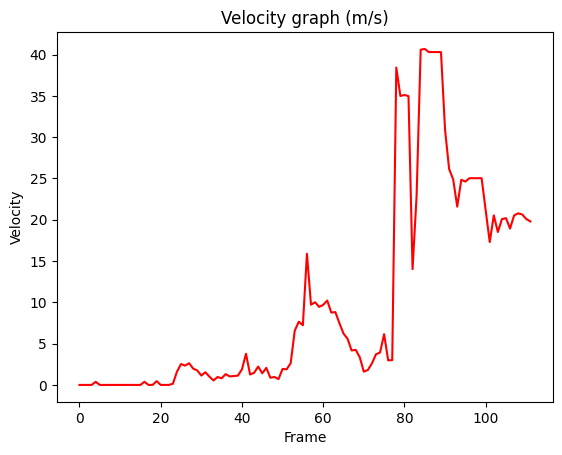

In [ ]:
# data to be plotted
x = np.arange(0, len(speeds))
y = speeds
 
# plotting
plt.title("Velocity graph (m/s)")
plt.xlabel("Frame")
plt.ylabel("Velocity")
plt.plot(x, speeds, color ="red")
plt.show()

[ 0.          0.          0.          0.          0.38034424  0.
  0.          0.          0.          0.          0.          0.
  0.          0.          0.          0.          0.38034424  0.
  0.          0.45745446  0.          0.          0.          0.13899666
  1.5946299   2.52311485  2.3391944   2.62500368  1.97545874  1.75195164
  1.13396744  1.53745048  1.00111522  0.54094648  0.95938358  0.80333871
  1.30785686  1.03328774  1.07577597  1.12223354  1.8793546   3.77484084
  1.25920021  1.47556093  2.22160264  1.40858303  2.06644475  0.86971333
  0.96259626  0.70139596  1.93567702  1.8879992   2.63528161  6.56763143
  7.65705907  7.22241807 15.8852193   9.71031133 10.00973544  9.45000663
  9.69633153 10.21408409  8.76148583  8.81991235  7.47143988  6.2208763
  5.58321142  4.17156527  4.24917492  3.35784253  1.60891089  1.80813589
  2.60913998  3.71287129  3.92456633  6.14340562  2.97116221  3.00334566
 38.4283919  34.98443145 35.10481254 34.9663698  14.0217357  22.92362055
 40

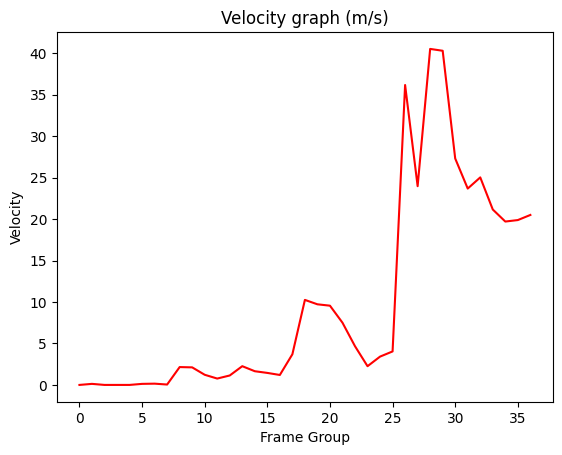

In [ ]:
# data to be plotted

number_of_eliminated = 0
while len(speeds) % 3 != 0:
  speeds.pop()
  number_of_eliminated = number_of_eliminated + 1

new_speeds = np.array(speeds)
print(new_speeds)
new_speeds = np.reshape(new_speeds,[int(new_speeds.shape[0]/3),3])

y = new_speeds.mean(axis=1)
print(y.shape)
x = y.shape[0]
x = np.arange(0, x)

# plotting
plt.title("Velocity graph (m/s)")
plt.xlabel("Frame Group")
plt.ylabel("Velocity")
plt.plot(x, y, color ="red")
plt.show()